<a href="https://colab.research.google.com/github/smorenorod/Antenna/blob/main/Antenna_Test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from six import StringIO
from sklearn.decomposition import PCA
from plotly.subplots import make_subplots
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy/score calculation
from sklearn.model_selection import cross_validate
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn import svm
from sklearn.neural_network import MLPClassifier
from sklearn.neural_network import MLPRegressor
from sklearn.impute import SimpleImputer
from sklearn.tree import DecisionTreeRegressor
from imblearn.over_sampling import SMOTE

In [ ]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:

data_df=pd.read_csv('/content/drive/MyDrive/data.csv').drop(columns=['Unnamed: 0'])

In [ ]:
max_data=data_df[data_df['service']=='Max']


#Data quality

In [ ]:
#missing data

missing = max_data.isnull().sum()/max_data.shape[0]*100
missing.sort_values(ascending=False)

,0
active_promos,100.000000
monthly_promo_discount,100.000000
plan_name,39.495826
plan_term_length,39.495826
plan_ads,39.495826
monthly_price,39.495826
marital_status_name,18.685776
total_service_tenure,1.183405
num_prev_service_subs,1.183405
current_service_tenure,1.183405


In [ ]:
# Plan name check
max_data.loc[max_data['subscriber']==False, 'plan_name']


,plan_name
40,Standard
563,Basic
765,Standard
871,Standard
939,Premium
...,...
1429952,Standard
1430021,Premium
1430176,NaN
1430235,Premium


## There are no promotions or discounts for MAX, so related features are excluded

In [ ]:
max_data=max_data.drop(['active_promos','monthly_promo_discount','service'], axis=1)

#qualitative and Quantitative features split

In [ ]:
#categorical features
cat_columns=['distributor',
'plan_name',
'plan_ads',
'plan_term_length',
'subscriber',
'age_group_name',
'customer_of_comcast',
'education_name',
'ethnicity_name_v2',
'gender_name',
'has_children',
'household_income_name_v2',
'is_cancel',
'is_gross_add',
'marital_status_name',
'state_name',
'subs_to_vmvpd',
'zip_code' ]

cat_df=max_data[cat_columns]
cat_df.shape

(454367, 18)

In [ ]:
# numeric features
cat_columns_copy = cat_columns.copy()

cuant_df = max_data[max_data.columns.difference(cat_columns_copy)]
cuant_df.shape

(454367, 6)

## subscriber Vs all

In [ ]:
# columns
columns = cat_df.drop(['subscriber'], axis=1)

r, c = 5, 4
pos = [(x+1, y+1) for x in range(r) for y in range(c)]

# Create subplots with titles for each variable
fig = make_subplots(rows=r, cols=c, subplot_titles=[f'{"subscriber"} vs {y}' for y in columns])

# Loop over all columns against "subscriber"
for col, s in zip(columns, pos):
    # Create the contingency table
    tabla_contingencia = cat_df.pivot_table(index='subscriber', columns=col, aggfunc='size', fill_value=0)

    # Calculate the total percentage across all cells
    tabla_contingencia_porcentaje = tabla_contingencia / tabla_contingencia.sum().sum() * 100

    # Generate the text for percentages
    text = tabla_contingencia_porcentaje.applymap(lambda x: f'{x:.1f}%')

    # Create each heatmap
    heatmap = go.Heatmap(
        z=tabla_contingencia_porcentaje.values,
        x=tabla_contingencia_porcentaje.columns,
        y=tabla_contingencia_porcentaje.index,
        text=text.values,
        texttemplate="%{text}",
        colorscale='YlGnBu',
        zmin=0, zmax=100,
        showscale=True
    )

    # Add the heatmaps to the subplot
    fig.add_trace(heatmap, row=s[0], col=s[1])

# Update layout
fig.update_layout(height=1300, width=1400)

# Show the figure
fig.show()


<ipython-input-26-2fd48a6b1072>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-26-2fd48a6b1072>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-26-2fd48a6b1072>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-26-2fd48a6b1072>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-26-2fd48a6b1072>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-26-2fd48a6b1072>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-26-2fd48a6b1072>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-26-2fd48a6b1072>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-26-2fd48a6b1072>:19: Futu

#exluding plan_term_length since it has only one level and Zip code since number of zip codes is large and to add value to de model will need to be mapped to a more informative variables like Geospatial Features or Socioeconomic Data

In [ ]:
max_data=max_data.drop(['plan_term_length','zip_code','panelist_id'], axis=1)

# new coategorical

In [ ]:
#categorical features
cat_columns=['distributor',
'plan_name',
'plan_ads',
'subscriber',
'age_group_name',
'customer_of_comcast',
'education_name',
'ethnicity_name_v2',
'gender_name',
'has_children',
'household_income_name_v2',
'is_cancel',
'is_gross_add',
'marital_status_name',
'state_name',
'subs_to_vmvpd']

cat_df=max_data[cat_columns]
cat_df.shape

(454367, 16)

In [ ]:
# numeric features
cat_columns_copy = cat_columns.copy()
cat_columns_copy.remove('plan_name')

cuant_df = max_data[max_data.columns.difference(cat_columns_copy)]
cuant_df.shape

(454367, 6)

## plan_name Vs all

# change plan name for a shorter one

In [ ]:

cat_df = cat_df.replace({"Standard with Ads": 'Stand_Ads'})

cat_df['plan_name'].value_counts()

,count
plan_name,
Premium,117928
Standard,101881
Basic,43420
Stand_Ads,11682


In [ ]:
cat_df['is_gross_add'].value_counts()

,count
is_gross_add,
False,447088
True,7279


In [ ]:
# columns
columns = cat_df.drop(['plan_name'], axis=1)

r, c = 5, 4
pos = [(x+1, y+1) for x in range(r) for y in range(c)]

# Create subplots with titles for each columns
fig = make_subplots(rows=r, cols=c, subplot_titles=[f'{"plan_name"} vs {y}' for y in columns])

# Loop over all columns against "subscriber"
for col, s in zip(columns, pos):
    # Create the contingency table
    tabla_contingencia = cat_df.pivot_table(index='plan_name', columns=col, aggfunc='size', fill_value=0)

    # Calculate the total percentage across all cells
    tabla_contingencia_porcentaje = tabla_contingencia / tabla_contingencia.sum().sum() * 100

    # Generate the text for percentages
    text = tabla_contingencia_porcentaje.applymap(lambda x: f'{x:.1f}%')

    # Create each heatmap
    heatmap = go.Heatmap(
        z=tabla_contingencia_porcentaje.values,
        x=tabla_contingencia_porcentaje.columns,
        y=tabla_contingencia_porcentaje.index,
        text=text.values,
        texttemplate="%{text}",
        colorscale='YlGnBu',
        zmin=0, zmax=100,
        showscale=True
    )

    # Add the heatmaps to the subplot
    fig.add_trace(heatmap, row=s[0], col=s[1])

# Update layout
fig.update_layout(height=1300, width=1400)

# Show the figure
fig.show()


<ipython-input-214-830a41003cd5>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-214-830a41003cd5>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-214-830a41003cd5>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-214-830a41003cd5>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-214-830a41003cd5>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-214-830a41003cd5>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-214-830a41003cd5>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-214-830a41003cd5>:19: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

<ipython-input-214-830a41003cd5>

#Replace 48+ by 48 to keep the numeric featureas as numeric

In [ ]:

cuant_df = cuant_df.replace({"48+": 48})



In [ ]:

variables=cuant_df.drop(['plan_name'], axis=1)

r,c=4,4
pos = [(x+1, y+1) for x in range(r) for y in range(c)]

fig = make_subplots(rows=r, cols=c)

for col,s in zip(variables,pos):

    fig.add_trace(go.Box(y=cuant_df[col],x=cuant_df['plan_name'],name=col, boxmean=True),row=s[0], col=s[1])

fig.update_layout(height=1300, width=
                  1400, title_text="Boxplots By Feature")
fig.show()

In [ ]:
# Convert 'time_period' to datetime
max_data['time_period'] = pd.to_datetime(max_data['time_period'], format='%Y-%m')

In [ ]:
# Group by 'time_period' and 'is_cancel' and calculate the count
is_cancel_counts = max_data.groupby(['time_period', 'is_cancel']).size().reset_index(name='count')

# Calculate the total count for each 'time_period'
total_counts = max_data.groupby('time_period').size().reset_index(name='total_count')

# Merge the two max_dataframes to calculate proportions
merged_max_data = pd.merge(is_cancel_counts, total_counts, on='time_period')

# Calculate the proportion of each is_cancel per 'time_period'
merged_max_data['proportion'] = merged_max_data['count'] / merged_max_data['total_count'] * 100

# Pivot the data to have categories as columns for easier plotting
pivot_data = merged_max_data.pivot(index='time_period', columns='is_cancel', values='proportion')


<Figure size 1000x600 with 0 Axes>

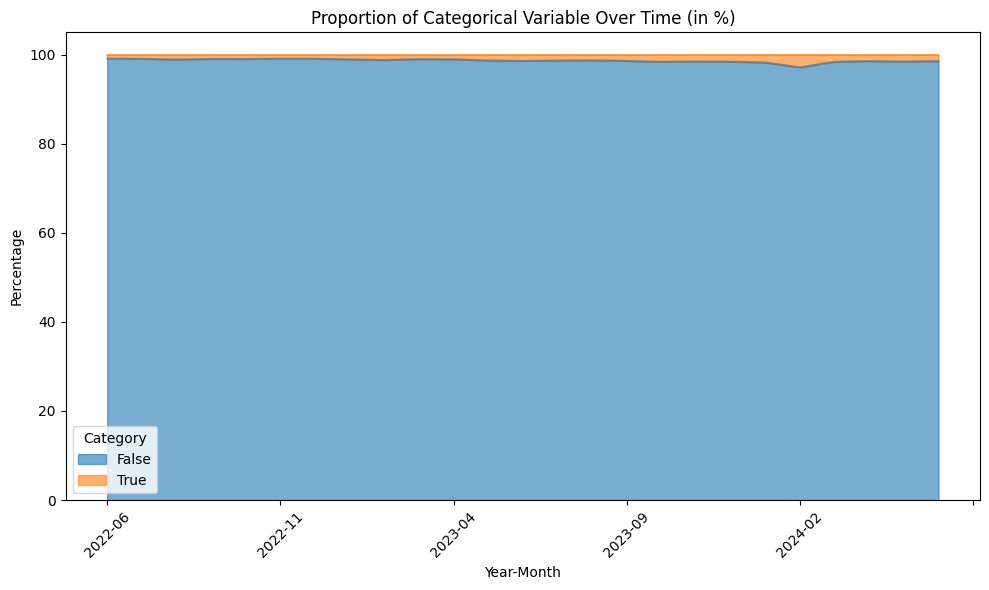

In [ ]:
# Step 5: Plot the proportion of each subscriber over time
plt.figure(figsize=(10, 6))

# Plot the area plot
pivot_data.plot(kind='area', stacked=True, alpha=0.6, figsize=(10, 6))

# Customize the plot
plt.title('Proportion of Categorical Variable Over Time (in %)')
plt.xlabel('Year-Month')
plt.ylabel('Percentage')
plt.xticks(rotation=45)
plt.legend(title='Category')
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
max_data.is_cancel.value_counts()

,count
is_cancel,
False,448278
True,6089


<Figure size 1000x600 with 0 Axes>

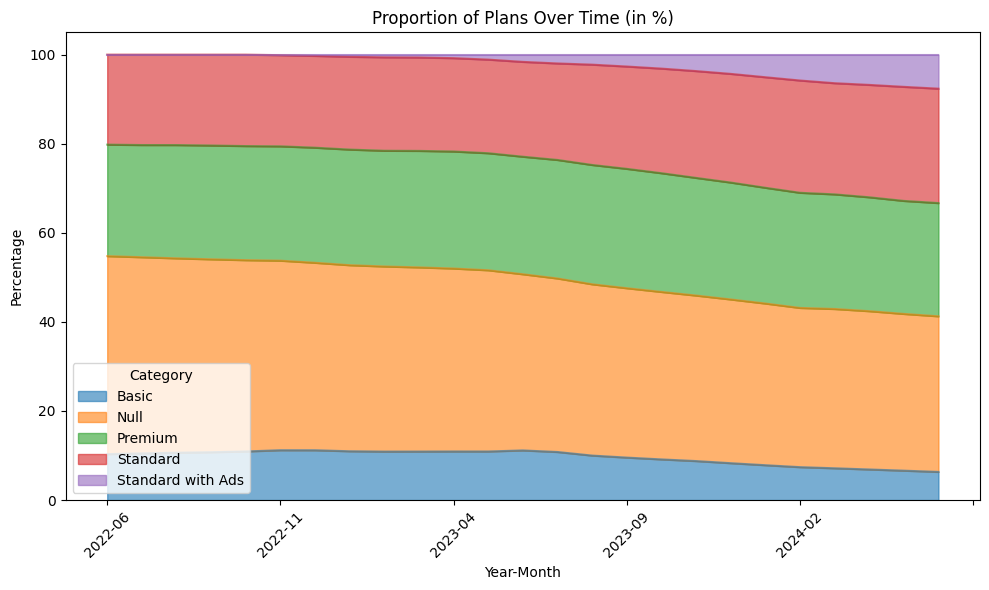

In [ ]:

max_data['plan_name'] = max_data['plan_name'].fillna('Null')

#  Group by 'time_period' and 'plan_name' and calculate the count
plan_name_counts = max_data.groupby(['time_period', 'plan_name']).size().reset_index(name='count')

#  Calculate the total count for each 'time_period'
total_counts = max_data.groupby('time_period').size().reset_index(name='total_count')

#  Merge the two max_dataframes to calculate proportions
merged_max_data = pd.merge(plan_name_counts, total_counts, on='time_period')

#  Calculate the proportion of each plan_name per 'time_period'
merged_max_data['proportion'] = merged_max_data['count'] / merged_max_data['total_count'] * 100

#  Pivot the data to have categories as columns for easier plotting
pivot_data = merged_max_data.pivot(index='time_period', columns='plan_name', values='proportion')

#  Plot the proportion of each plan_name over time
plt.figure(figsize=(10, 6))

# Plot the area plot
pivot_data.plot(kind='area', stacked=True, alpha=0.6, figsize=(10, 6))

# Customize the plot
plt.title('Proportion of Plans Over Time (in %)')
plt.xlabel('Year-Month')
plt.ylabel('Percentage')
plt.xticks(rotation=45)
plt.legend(title='Category')
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
#definir variables categóricas y numéricas para el procesamiento

#categóricas
cat_columns_copy=cat_df.columns.to_list().copy()
cat_columns_copy.remove('plan_name') # Remove 'plan_name'
cat_columns_copy.remove('plan_ads') # Remove 'plan_ads'
#numéricas
cuant_columns_copy=cuant_df.columns.to_list().copy()
cuant_columns_copy.remove('plan_name') # Remove 'plan_name'
cuant_columns_copy.remove('time_period') # Remove 'time_period'
cuant_columns_copy.remove('monthly_price') # Remove 'monthly_price'

In [ ]:
cuant_columns_copy

['current_service_tenure',
 'monthly_price',
 'num_prev_service_subs',
 'total_service_tenure']

In [ ]:
cuant_df.columns

Index(['current_service_tenure', 'monthly_price', 'num_prev_service_subs',
       'time_period', 'total_service_tenure'],
      dtype='object')

In [ ]:
# Preprocessing pipeline

# Categorical variables

cat_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),  # Impute with the most frequent category
    ('onehot', OneHotEncoder(handle_unknown='ignore'))  # OneHotEncoding to transform categorical variables
    ])

# Numerical variables

num_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),  # Impute with the median
    ('pow_transf', PowerTransformer(method='yeo-johnson', standardize=True)),  # Yeo-Johnson transformation (Box-Cox only accepts values >0) to handle outliers and then standardize
    ])

# Build the pipeline to preprocess all variables
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', cat_transformer, cat_columns_copy),
        ('num', num_transformer, cuant_columns_copy)])


## Decision tree

In [ ]:

# Concatenate the classifier with the pipeline.

clasif = Pipeline(steps=[('preprocessor', preprocessor),
                         ('classifier', DecisionTreeClassifier(class_weight='balanced',criterion="entropy"))])



In [ ]:
max_data.columns

Index(['time_period', 'distributor', 'plan_name', 'plan_ads', 'subscriber',
       'age_group_name', 'current_service_tenure', 'customer_of_comcast',
       'education_name', 'ethnicity_name_v2', 'gender_name', 'has_children',
       'household_income_name_v2', 'is_cancel', 'is_gross_add',
       'marital_status_name', 'monthly_price', 'num_prev_service_subs',
       'state_name', 'subs_to_vmvpd', 'total_service_tenure'],
      dtype='object')

In [ ]:
#train/test split

max_clean = max_data.dropna(subset=['plan_name'])

max_clean = max_clean.replace({"48+": 48})

X = max_clean.drop(['plan_name','plan_ads','time_period','monthly_price'], axis=1).reset_index(drop=True)

# Create the LabelEncoder
label_encoder = LabelEncoder()

# Convert all labels to numeric values
Y = label_encoder.fit_transform(max_clean['plan_name'].reset_index(drop=True))

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

In [ ]:
y_train

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:

# Entrenar el clasificador de Árbol de Decisión
clasif = clasif.fit(X_train, y_train)

# Predecir la respuesta para el conjunto de datos de prueba
y_pred = clasif.predict(X_test)

# Precisión del modelo
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
# Puntaje F1 debido a clases desbalanceadas.
print("f1_score:", metrics.f1_score(y_test, y_pred, average='weighted')) # Cambiar average a 'weighted' por ser multiclase


Accuracy: 0.8518199675049106
f1_score: 0.8535588131152321


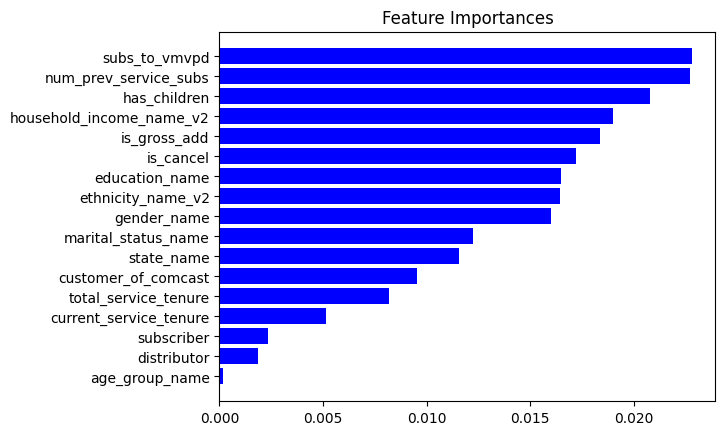

In [ ]:
# Access the DecisionTreeClassifier within the pipeline
feature=list(X_train.columns.values)
importances = clasif.named_steps['classifier'].feature_importances_

indices = np.argsort(importances)

# Ensure that indices are within the valid range of feature list
indices = indices[indices < len(feature)]  # Filter out indices that are out of range

plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [feature[i] for i in indices])
plt.show()

In [ ]:
# Grid search for PCA + decision tree

parameter_space = {
    # 'pca__n_components': np.arange(1, 24, 1),
    'classifier__max_depth': range(3, 20)  # Max depth range for pruned decision tree
}

# Perform cross-validation with grid search using weighted F1 as the evaluation metric for multiclass
grid = GridSearchCV(clasif, parameter_space, n_jobs=-1, cv=5, scoring='f1_weighted')
grid.fit(X_train, y_train)

# Best parameters
print('Grid best parameter: ', grid.best_params_)
print('Grid best f1: ', grid.best_score_)

grid_pred = grid.predict(X_test)


Grid best parameter:  {'classifier__max_depth': 19}
Grid best f1:  0.48571354619626456


# Support vector Machine Clasifffier con variables seleccionadas

In [ ]:
# Build the pipeline to preprocess all variables
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', cat_transformer, cat_columns_copy),
        ('num', num_transformer, cuant_columns_copy)])

# Concatenate the SVM classifier with the pipeline
clasif_2 = Pipeline(steps=[('preprocessor', preprocessor),
                           ('classifier', svm.SVC(kernel='rbf', decision_function_shape='ovr', max_iter=1000))])


In [ ]:
# SVM with all variables

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Train the SVM classifier
clasif_2 = clasif_2.fit(X_train, y_train)

# Predict the response for the test dataset
y_pred = clasif_2.predict(X_test)

# Model accuracy
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

# F1 score due to imbalanced classes
print("f1_score:", metrics.f1_score(y_test, y_pred, average='weighted'))  # Using 'weighted' average for multiclass classification


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:297: ConvergenceWarning:

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.



Accuracy: 0.30278633266241484
f1_score: 0.2900409684958051


# Neural network

In [ ]:
# Build the pipeline to preprocess all variables
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', cat_transformer, cat_columns_copy),
        ('num', num_transformer, cuant_columns_copy)])

# Concatenate the MLPClassifier with the pipeline
clasif_3 = Pipeline(steps=[('preprocessor', preprocessor),
                           # ('pca', PCA(n_components=5)), # Uncomment to add PCA for dimensionality reduction
                           ('classifier', MLPClassifier(max_iter=100))])

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Train the MLPClassifier
clasif_3 = clasif_3.fit(X_train, y_train)

# Predict the response for the test dataset
y_pred = clasif_3.predict(X_test)

# Model accuracy
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

# F1 score due to imbalanced classes
print("f1_score:", metrics.f1_score(y_test, y_pred, average='weighted'))  # Using 'weighted' average for multiclass classification


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


Accuracy: 0.6914421514659165
f1_score: 0.6742925310898648


In [ ]:
# Hyperparameter space
parameter_space = {
    'classifier__hidden_layer_sizes': [(10,30,10), (20,)],  # Different configurations for hidden layers
    'classifier__activation': ['tanh', 'relu'],  # Activation functions to try
    'classifier__solver': ['sgd', 'adam'],  # Solvers for weight optimization
    'classifier__alpha': [0.0001, 0.05],  # Regularization parameter
    'classifier__learning_rate': ['constant', 'adaptive']  # Learning rate schedules
}

# Perform cross-validation with grid search using weighted F1 as the evaluation metric for multiclass
grid = GridSearchCV(clasif_3, parameter_space, n_jobs=-1, cv=5, scoring='f1_weighted')
grid.fit(X_train, y_train)

# Best parameters
print('Grid best parameter: ', grid.best_params_)
print('Grid best f1: ', grid.best_score_)

# Predict with the best model
grid_pred = grid.predict(X_test)


KeyboardInterrupt: 

#Logistic Regression

In [ ]:
# Build the pipeline to preprocess all variables
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', cat_transformer, cat_columns_copy),
        ('num', num_transformer, cuant_columns_copy)])

# Concatenate the Logistic Regression classifier with the pipeline
clasif_4 = Pipeline(steps=[('preprocessor', preprocessor),
                           # ('pca', PCA(n_components=5)), # Uncomment to add PCA for dimensionality reduction
                           ('classifier', LogisticRegression(multi_class='ovr', solver='liblinear', C=1.0, penalty='l2'))])

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Train the Logistic Regression classifier
clasif_4 = clasif_4.fit(X_train, y_train)

# Predict the response for the test dataset
y_pred = clasif_4.predict(X_test)

# Model accuracy
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

# F1 score due to imbalanced classes
print("f1_score:", metrics.f1_score(y_test, y_pred, average='weighted'))  # Using 'weighted' average for multiclass classification


Accuracy: 0.45708950699614426
f1_score: 0.39732887614537493


In [ ]:
# Hyperparameter space
parameter_space = {
    'classifier__C': np.logspace(-3, 3, 7),
    'classifier__penalty': ["l1", "l2"],# l1 lasso l2 ridge
    #'pca__n_components': np.arange(1, 17, 2)
      }

# Perform cross-validation with grid search using weighted F1 as the evaluation metric for multiclass
grid = GridSearchCV(clasif_4, parameter_space, n_jobs=-1, cv=5, scoring='f1_weighted')
grid.fit(X_train, y_train)

# Best parameters
print('Grid best parameter: ', grid.best_params_)
print('Grid best f1: ', grid.best_score_)

grid_pred = grid.predict(X_test)

Grid best parameter:  {'classifier__C': 1.0, 'classifier__penalty': 'l2'}
Grid best f1:  0.3978675382861758
